In [1]:
# modular code
from master_functions_trains_jit import *

In [2]:
# Example usage
np.random.seed(42)
params = [50, 80, 100, 110, 110, 5]  # Example parameter list
# Convert to a Numba typed list
    
# params = [50, 5]  # Example parameter list

# params = [50, 80, 100, 110, 110, 100, 90, 80, 75, 70, 5]  # Example parameter list

# params = [50, 80, 100, 110, 118, 125, 130, 133, 135, 136, 5]  # Example parameter list

params = List([p for p in params])


bl = 20 # baseline
dt = 0.05

ISI = 20  # frequency in Hz
n = len(params) - 1  # number of responses is one less than the length of params
x = np.arange(0, 140, dt)
# Generate the individual and combined alpha responses
# all_resp, y = model_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='alpha')

# add a baseline
idx = int(bl/dt) - 1

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))

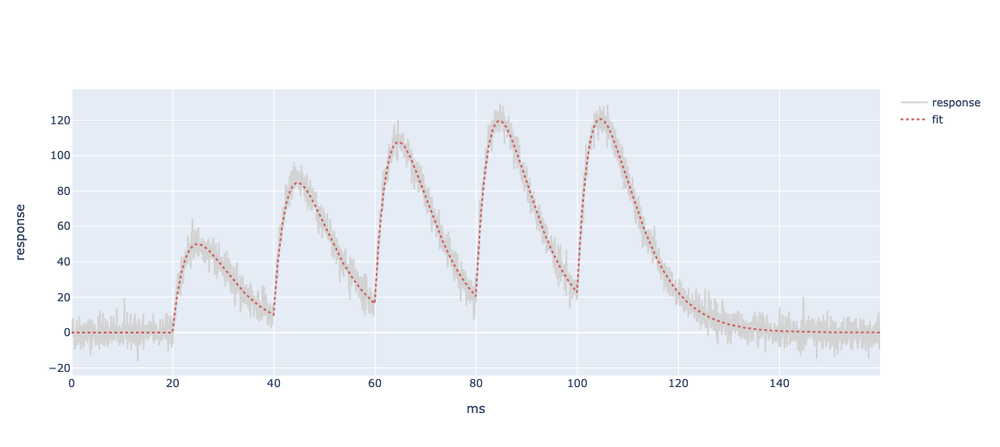

In [3]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig1.show()   

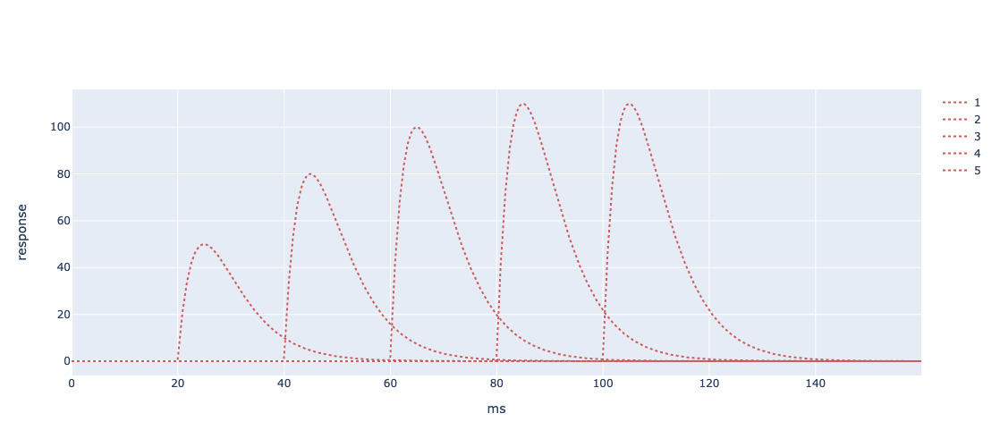

In [4]:
# Create the figure
fig2 = go.Figure()

# Plot each individual response
for i, yi in enumerate(all_y):
    fig2.add_trace(go.Scatter(x=x, y=yi, name=i+1, line=dict(color='indianred', dash='dot')))

# Set the axis labels
fig2.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig2.show()   


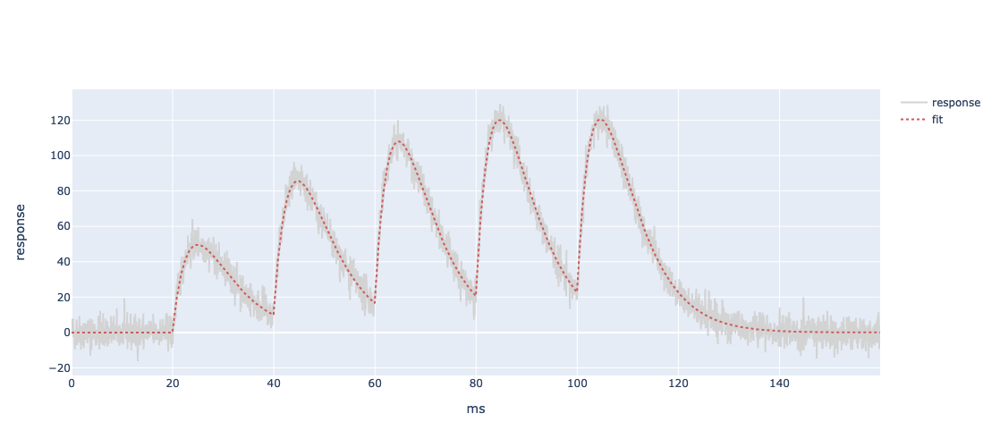

             A1      A2       A3       A4       A5      τ r20-80  d80-20  \
fit:     49.597  81.016  100.237  110.354  109.817  5.003  1.961  10.857   
AIC:  16921.376                                                            

          area  
fit:  6134.044  
AIC:            
CPU times: user 1.36 s, sys: 51.4 ms, total: 1.42 s
Wall time: 1.42 s


In [5]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='alpha', fit_method='DE', N=1)

In [6]:
# Example usage
np.random.seed(42)
params = [50, 80, 100, 5, 20, 30, 25, 15]  # Example parameter list [p11, p12, p13, T1, p21, p22, p23, T2]

params = [50, 80, 100, 110, 110, 5, 20, 30, 25, 15, 10, 15] 

# params = [50, 80, 5, 20, 30, 15] 
params = List([p for p in params])

bl = 20 # baseline
dt = 0.05
ISI = 20  
n = int(len(params)/2) - 1  # number of responses is one less than the length of params
x = np.arange(0, 140, dt)
# # Generate the individual and combined alpha responses
# all_resp, y = alpha2_alt_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='alpha2')

# add a baseline
idx = int(bl/dt) - 1

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))


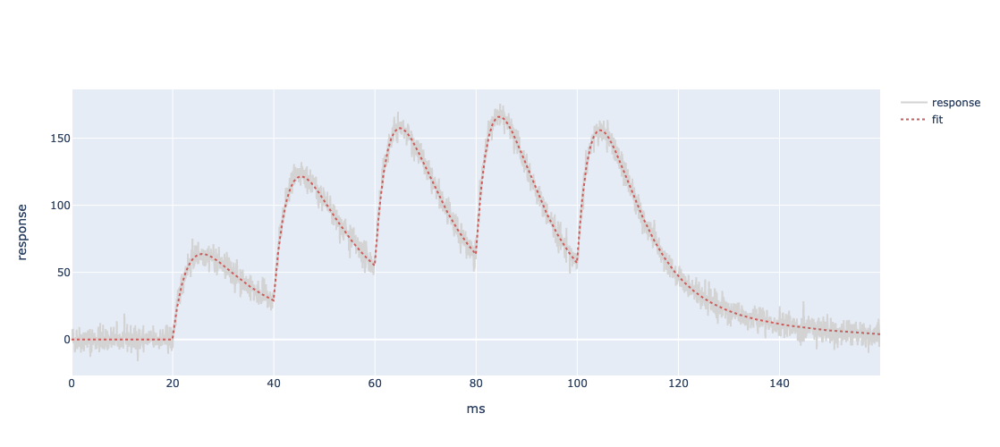

In [7]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig1.show()  

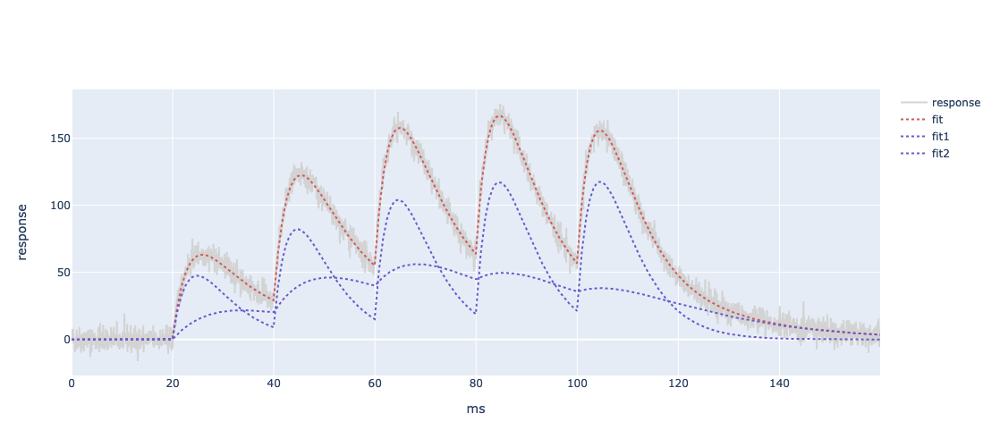

              A1      A2      A3       A4       A5       τ r20-80  d80-20  \
fast:     47.516  77.982  96.925  108.252  107.519   4.922  1.929   10.68   
slow:     21.764  32.932  29.294   18.092   13.434  13.799  5.409  29.942   
AIC:   16927.126                                                            

           area  
fast:  5862.783  
slow:  4332.819  
AIC:             
CPU times: user 10.1 s, sys: 14.5 ms, total: 10.2 s
Wall time: 10.8 s


In [8]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='alpha2', N=30)

In [9]:
# Example usage
np.random.seed(42)
params = [30, 60, 80, 90, 5, 20]  # params of form [A1, A2, A3, A4, T1, T2]
params = List([p for p in params])


bl = 20 # baseline
dt = 0.05
ISI = 20  
n = int(len(params)) - 2  # number of responses is one less than the length of params
x = np.arange(0, 160, dt)
# # Generate the individual and combined alpha responses
# all_resp, y = product_alt_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='product')

# add a baseline
idx = int(bl/dt) - 1

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))

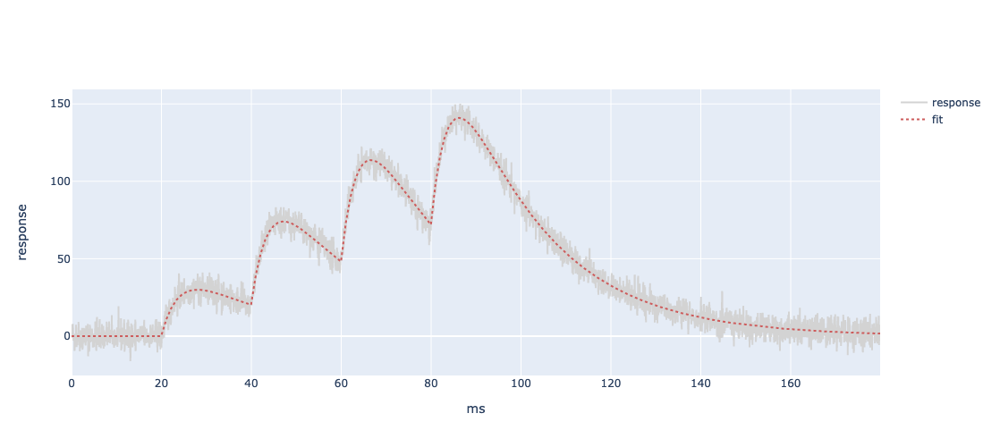

In [10]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig1.show()  

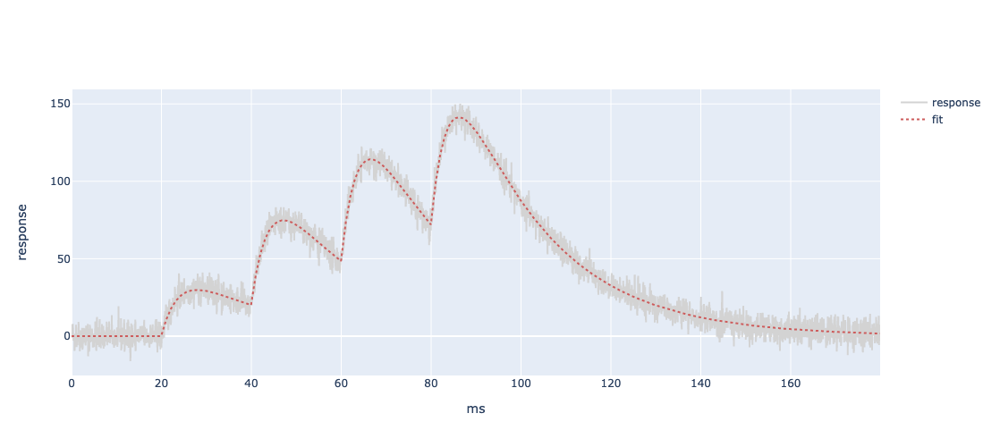

             A1      A2      A3      A4  τrise  τdecay  tpeak r20-80 d80-20  \
fit:     29.825  60.872  80.113  90.167  3.949  20.061  7.992  2.981  28.55   
AIC:  19406.456                                                               

          area  
fit:  7797.867  
AIC:            
CPU times: user 820 ms, sys: 2.51 ms, total: 822 ms
Wall time: 824 ms


In [11]:
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='product', fit_method='LS')

In [12]:
# sum of 2 product
# params of form [A1, A2, A3, A4, T1, T2]

# Example usage
np.random.seed(42)
params = [50, 80, 100, 5, 10, 20, 30, 15, 15, 30]  # Example parameter list [A11, A12, A13, T11, T12, A21, A22, A23, T21, T22]
params = List([p for p in params])

# params = [50, 5, 10, 100, 15, 30]  

bl = 20 # baseline
dt = 0.05
ISI = 20  
n = int(len(params)/2) - 2  # number of responses is one less than the length of params
x = np.arange(0, 160, dt)
# # Generate the individual and combined alpha responses
# all_resp, y = product2_alt_n(params, ISI, n, x)
all_resp, y = model_n(params, ISI, n, x, model='product2')

# add a baseline
idx = int(bl/dt) - 1
if idx < 0: idx=0

y = np.concatenate([np.zeros(idx), y])
x = np.arange(0, len(y))*dt

all_y = []
for res in all_resp:
    all_y.append(np.concatenate([np.zeros(idx), res]))
    
# add noise    
y = y + np.random.normal(0, 5, len(x))


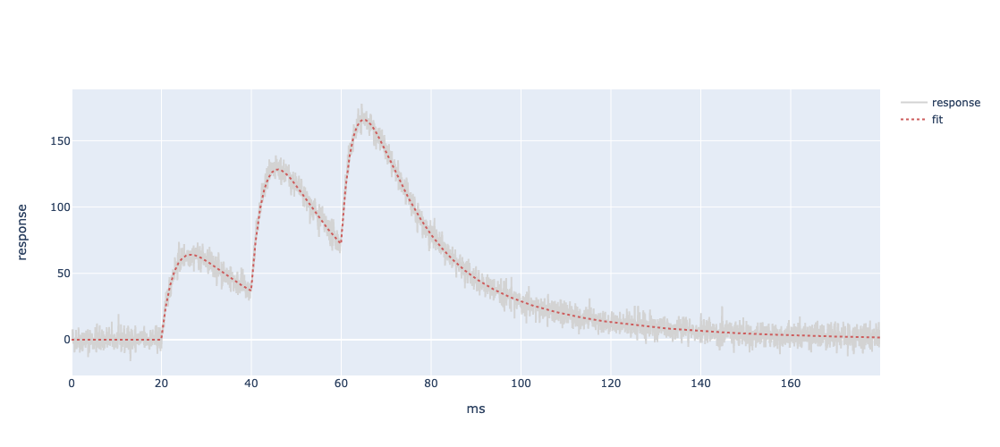

In [13]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))

# Set the axis labels
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig1.show() 


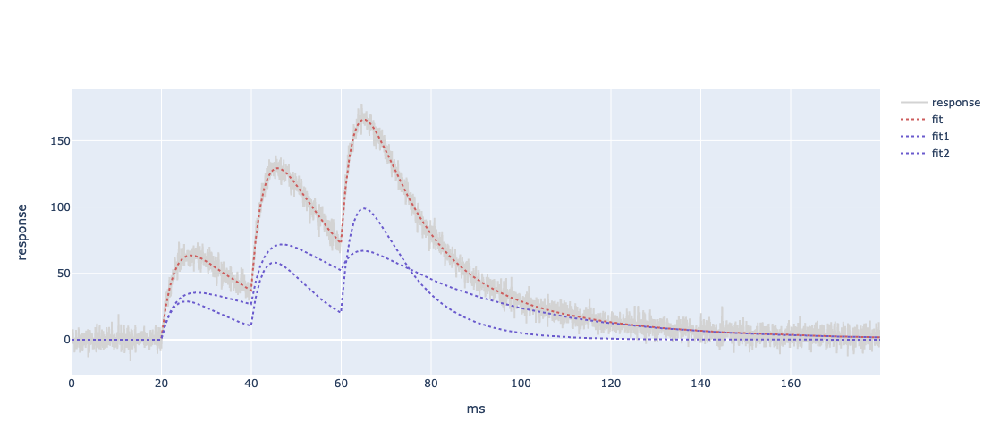

              A1      A2      A3  τrise  τdecay  tpeak r20-80  d80-20  \
fast:     35.531   50.84  24.224  3.174  30.719  8.034  2.859  42.773   
slow:     28.843  51.968  86.757  3.358  10.326   5.59   2.14   15.55   
AIC:   19411.879                                                        

           area  
fast:  4412.906  
slow:  2973.187  
AIC:             
CPU times: user 3.21 s, sys: 2.68 ms, total: 3.22 s
Wall time: 3.22 s


In [14]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='product2')

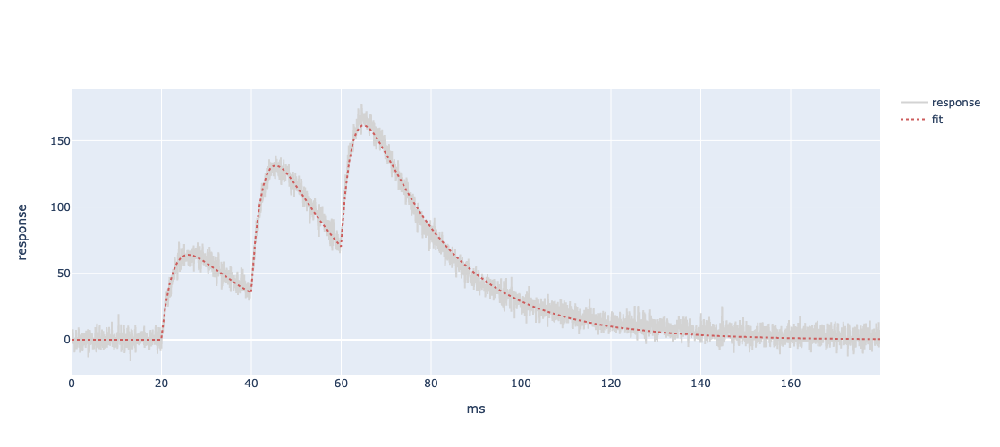

             A1       A2       A3  τrise  τdecay  tpeak r20-80 d80-20  \
fit:     63.952  105.191  109.221  2.667  18.676  6.056  2.211   26.2   
AIC:  20183.732                                                         

          area  
fit:  7189.748  
AIC:            
CPU times: user 586 ms, sys: 1.38 ms, total: 587 ms
Wall time: 587 ms


In [15]:
np.random.seed(42)
%time nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model='product')

In [16]:
################ compare to previous code
from master_functions import *

In [17]:
# generate alpha response
np.random.seed(42) # set a seed to make egs reproducible
params = [50, 5] 
dt = 0.05
x = np.arange(0, 50, dt) 
y = alpha_alt(params, x) + np.random.normal(0,2,len(x))

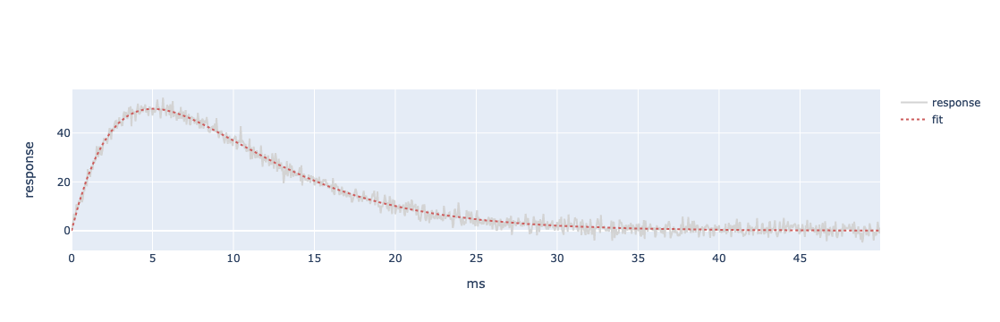

          peak      τ rise20-80 decay80-20     area
fit:    49.926  5.018     1.967     10.889  681.011
AIC:  4184.367                                     


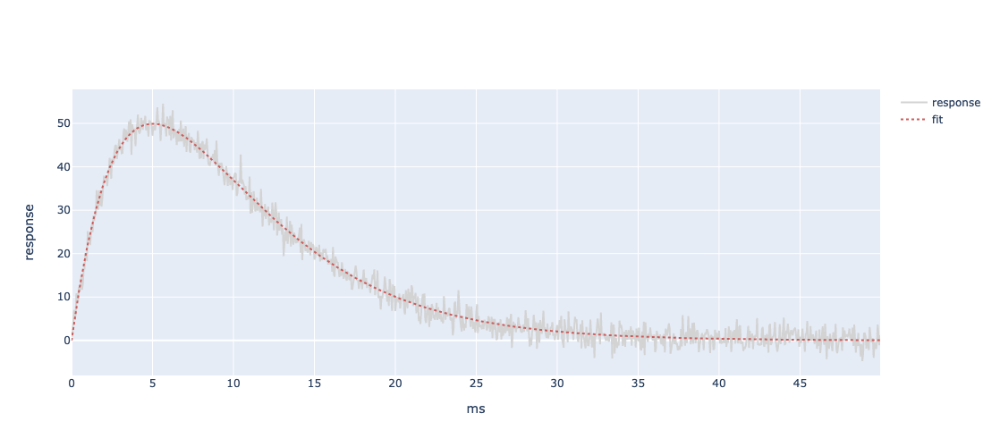

            A1      τ r20-80  d80-20     area
fit:    49.926  5.018  1.967  10.889  681.011
AIC:  4184.369                               


In [18]:
np.random.seed(42)
FITalpha(x, y)
nFIT(x=x, y=y, model='alpha')

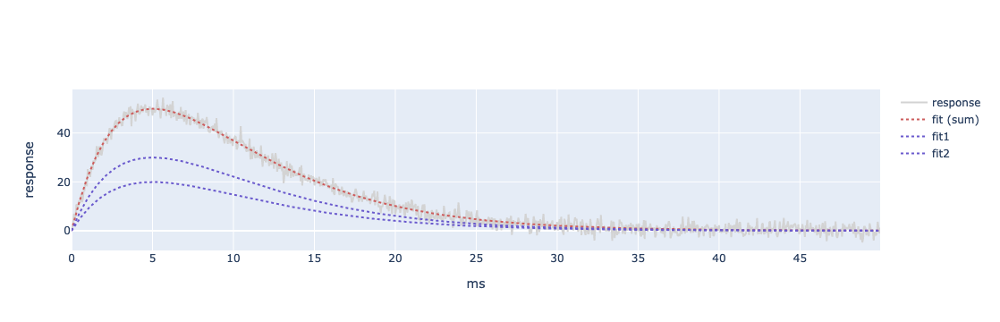

           peak      τ rise20-80 decay80-20     area
fast:    29.974  5.018     1.967     10.889  408.855
slow:    19.952  5.018     1.967     10.889  272.156
AIC:   4188.367                                     


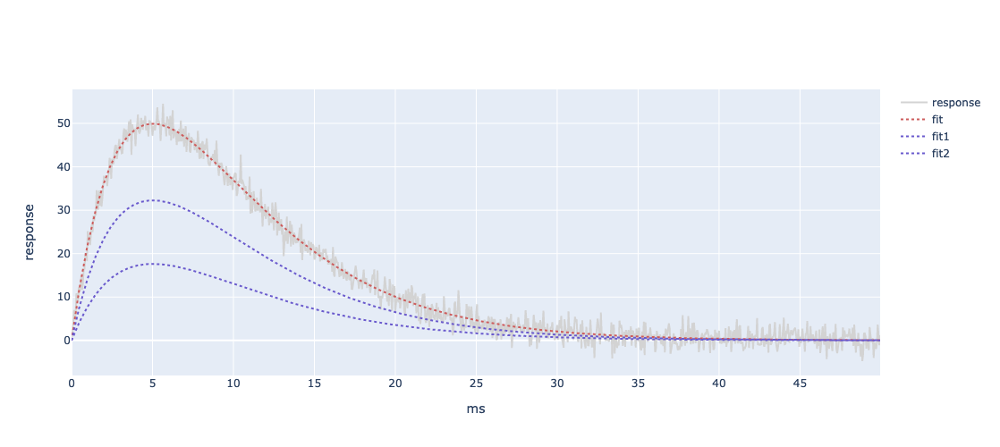

             A1      τ r20-80  d80-20     area
fast:    32.281  5.018  1.967  10.889  440.327
slow:    17.645  5.018  1.967  10.889  240.684
AIC:   4188.375                               


In [19]:
np.random.seed(42) 
FITalpha2(x, y)
nFIT(x=x, y=y, model='alpha2')

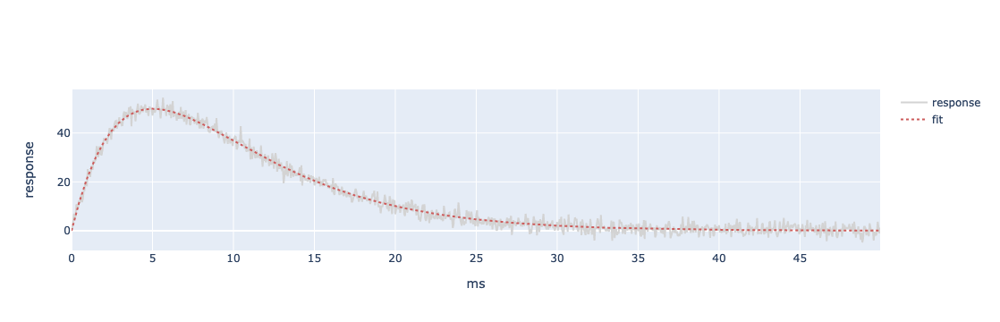

          peak  τrise τdecay  tpeak rise20-80 decay80-20     area
fit:    49.929  4.931  5.106  5.017     1.967      10.89  681.062
AIC:  4186.428                                                   


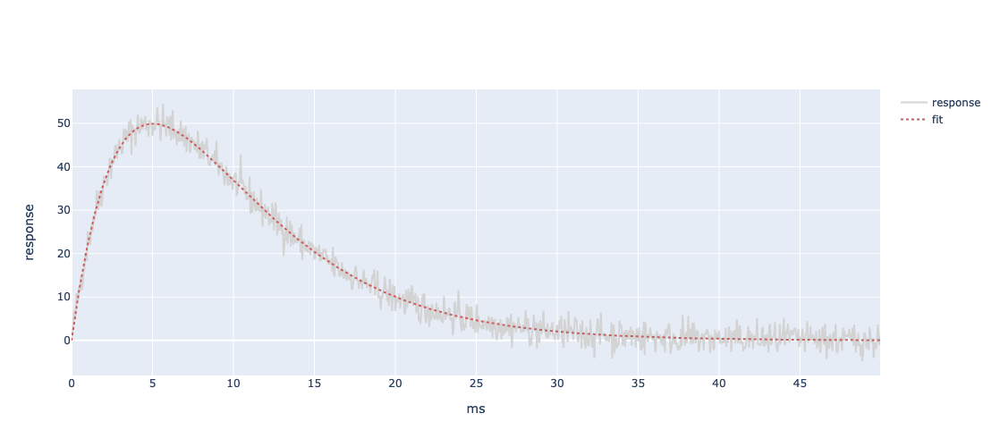

            A1  τrise τdecay  tpeak r20-80  d80-20     area
fit:    49.924  4.981  5.055  5.018  1.967  10.888  680.947
AIC:  4186.383                                             


In [20]:
np.random.seed(42) 
FITproduct(x, y)
nFIT(x=x, y=y, model='product')

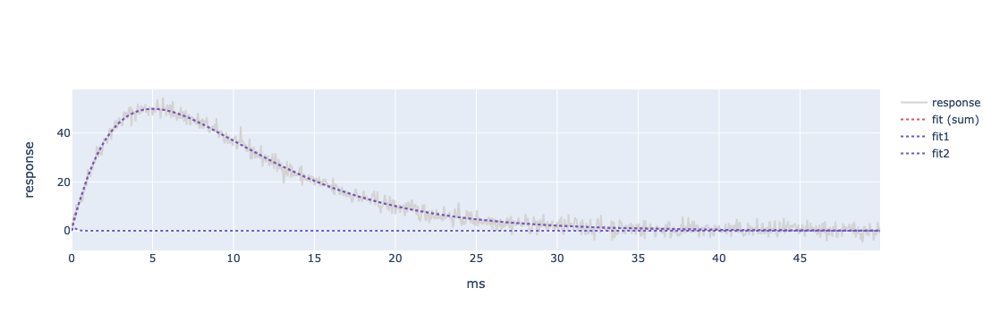

           peak  τrise τdecay  tpeak rise20-80 decay80-20     area
fast:     1.260  0.104  0.107  0.106     0.041      0.229    0.361
slow:    49.917  4.927   5.11  5.017     1.967      10.89  680.912
AIC:   4190.832                                                   


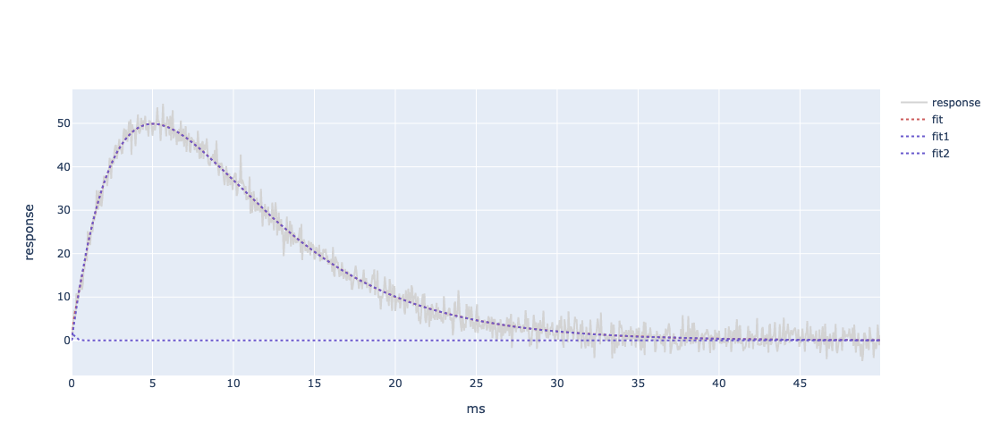

             A1  τrise τdecay  tpeak r20-80  d80-20     area
fast:     1.250  0.105  0.108  0.106  0.042   0.231    0.362
slow:    49.920  4.995  5.043  5.019  1.967  10.891  681.038
AIC:   4190.783                                             


In [21]:
np.random.seed(42) 
FITproduct2(x, y)
nFIT(x=x, y=y, model='product2')


In [22]:
######################### fitting and comparing 4 fits to sum of 2 alpha functions #########################
# _alt versions take a1_max not a1 ie a1_max etc is the actual maximum of the alpha synapse
np.random.seed(42) # set a seed to make egs reproducible
params = [35, 5, 20, 25] 
dt = 0.05
x = np.arange(0, 150, dt) 
# y = alpha2(params, x) + np.random.normal(0,2,len(x))
y = alpha2_alt(params, x) + np.random.normal(0,2,len(x))

# y = model_n(params, ISI=0, n=1, x=x, model='alpha2')[1] + np.random.normal(0,2,len(x))


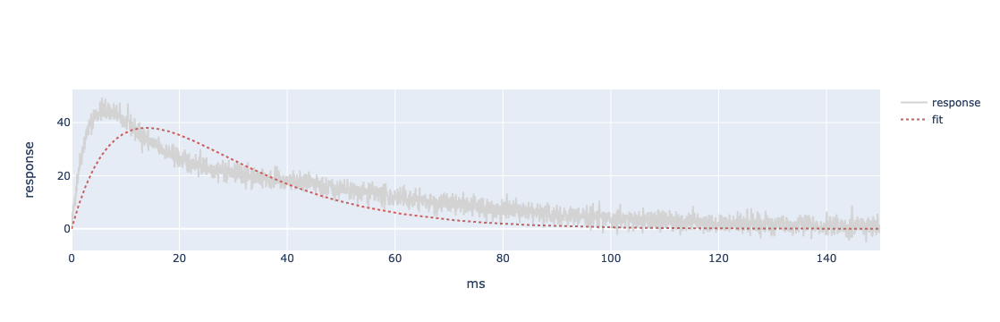

           peak       τ rise20-80 decay80-20      area
fit:     38.040  13.949     5.468     30.269  1442.424
AIC:  19198.264                                       


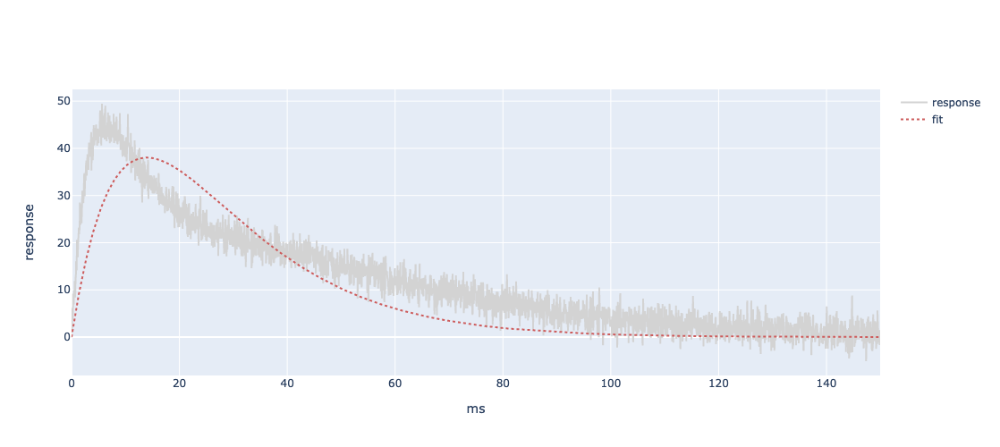

             A1       τ r20-80  d80-20      area
fit:     38.040  13.949  5.468  30.269  1442.419
AIC:  19198.264                                 


In [23]:
np.random.seed(42)
FITalpha(x, y)
nFIT(x=x, y=y, model='alpha')

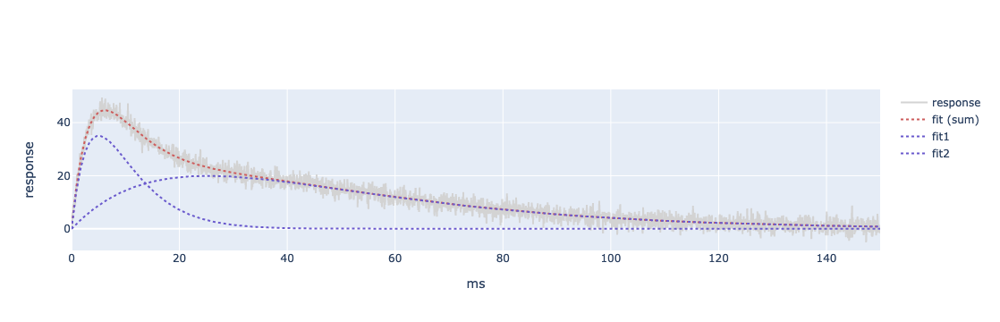

            peak       τ rise20-80 decay80-20      area
fast:     35.017   5.037     1.975     10.931   479.504
slow:     19.950  25.233     9.891     54.753  1368.404
AIC:   12596.360                                       


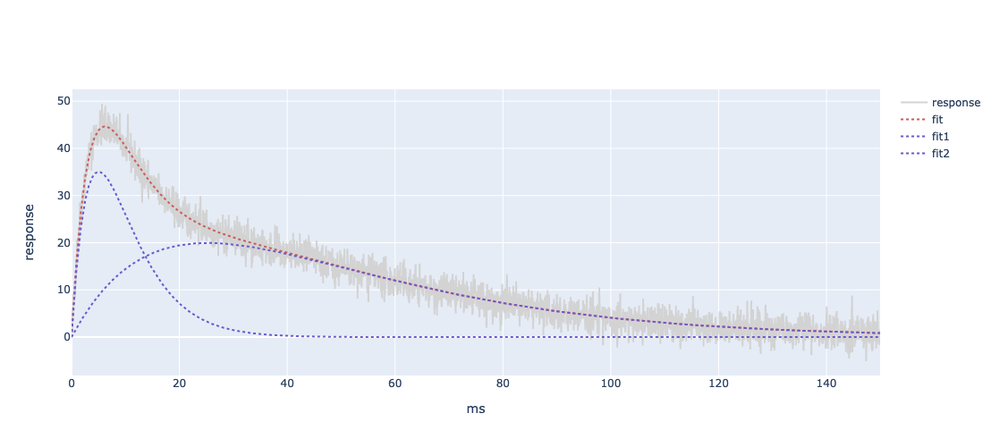

              A1       τ r20-80  d80-20      area
fast:     35.017   5.037  1.975  10.931   479.504
slow:     19.950  25.233  9.891  54.753  1368.404
AIC:   12596.362                                 


In [24]:
np.random.seed(42) 
FITalpha2(x, y)
nFIT(x=x, y=y, model='alpha2')

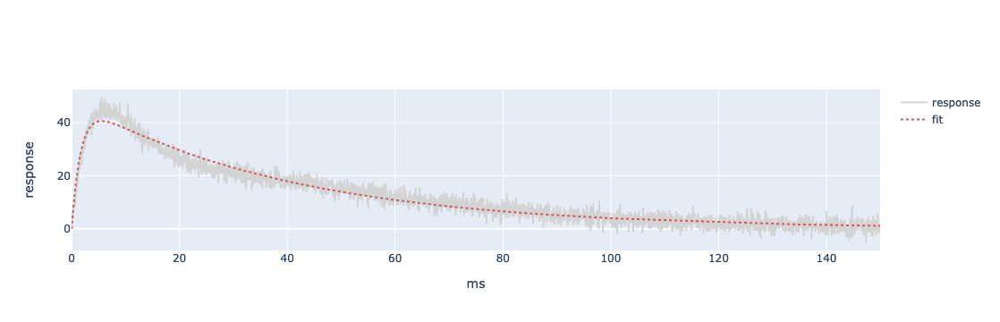

           peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fit:     40.584  1.693  39.928  5.587      1.82     55.355  1863.805
AIC:  13751.648                                                     


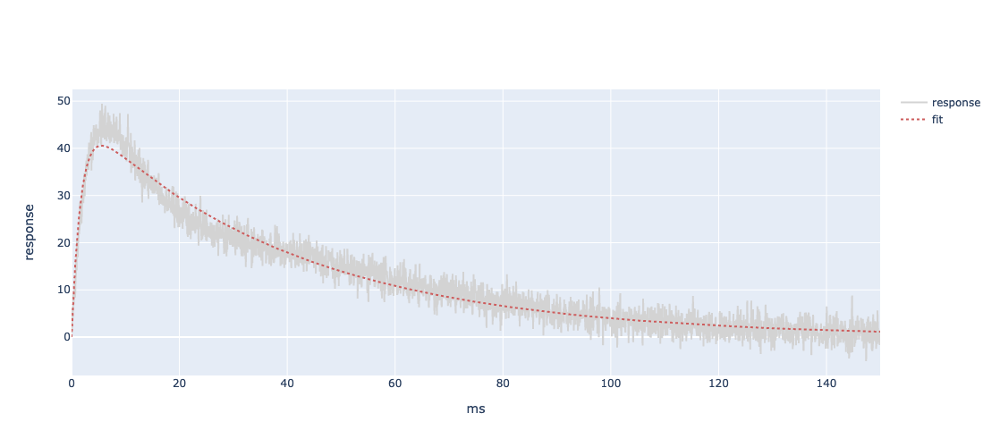

             A1  τrise  τdecay  tpeak r20-80  d80-20      area
fit:     40.584  1.693  39.928  5.587   1.82  55.356  1863.806
AIC:  13751.650                                               


In [25]:
np.random.seed(42) 
FITproduct(x, y)
nFIT(x=x, y=y, model='product', fit_method='MLE')

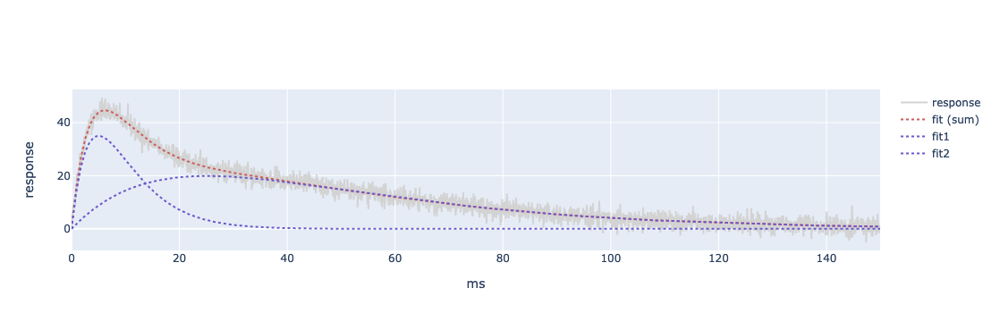

            peak   τrise  τdecay   tpeak rise20-80 decay80-20      area
fast:     35.007   4.861   5.224   5.039     1.975     10.945   479.773
slow:     19.936  24.821  25.665  25.238     9.893     54.778  1367.924
AIC:   12600.580                                                       


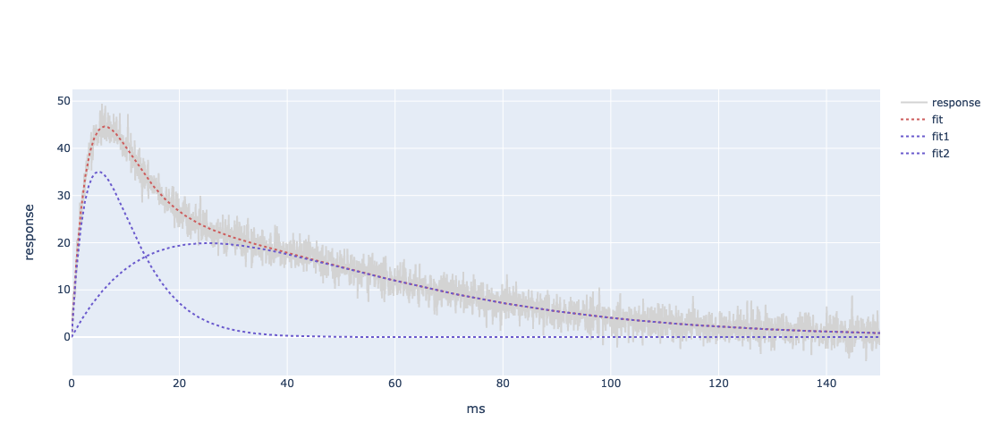

              A1   τrise  τdecay   tpeak r20-80  d80-20      area
fast:     35.038   4.574   5.549    5.03   1.97  10.997    481.31
slow:     19.906  24.495  26.034  25.249  9.897  54.829  1366.876
AIC:   12601.801                                                 


In [26]:
np.random.seed(42) 
FITproduct2(x, y)
nFIT(x=x, y=y, model='product2')

In [27]:
np.random.seed(42) # set a seed to make egs reproducible
params = [50, 5, 20] 
dt = 0.05
x = np.arange(0, 150, dt) 
y = product_alt(params, x) + np.random.normal(0,2,len(x))


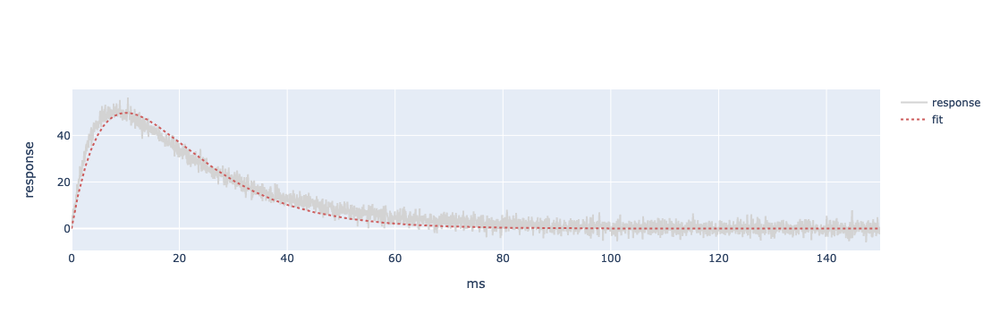

           peak       τ rise20-80 decay80-20      area
fit:     49.694  10.106     3.962      21.93  1365.183
AIC:  14766.944                                       


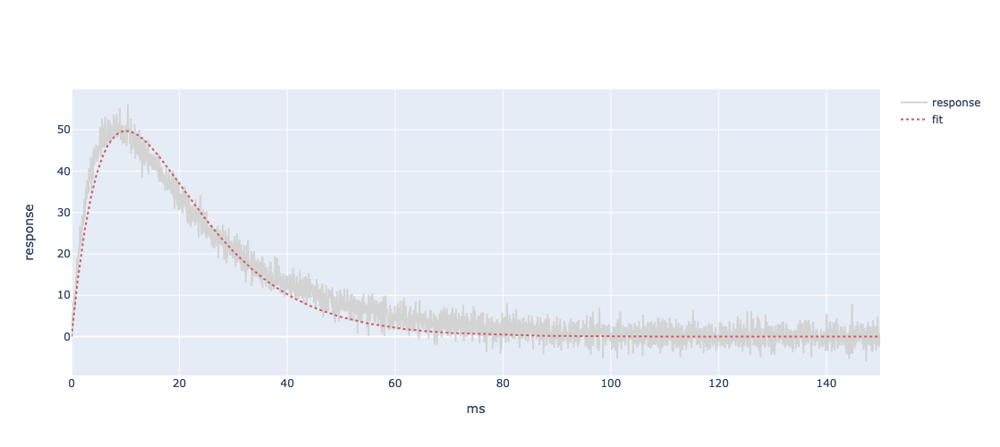

             A1       τ r20-80 d80-20      area
fit:     49.694  10.106  3.962  21.93  1365.183
AIC:  14766.945                                


In [28]:
np.random.seed(42)
FITalpha(x, y)
nFIT(x=x, y=y, model='alpha')

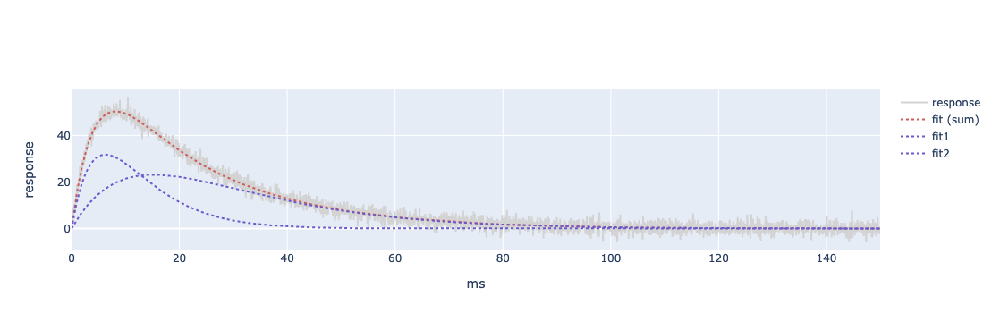

            peak       τ rise20-80 decay80-20     area
fast:     31.800   6.271     2.458     13.607  542.072
slow:     23.135  15.226     5.969      33.04  957.554
AIC:   12595.158                                      


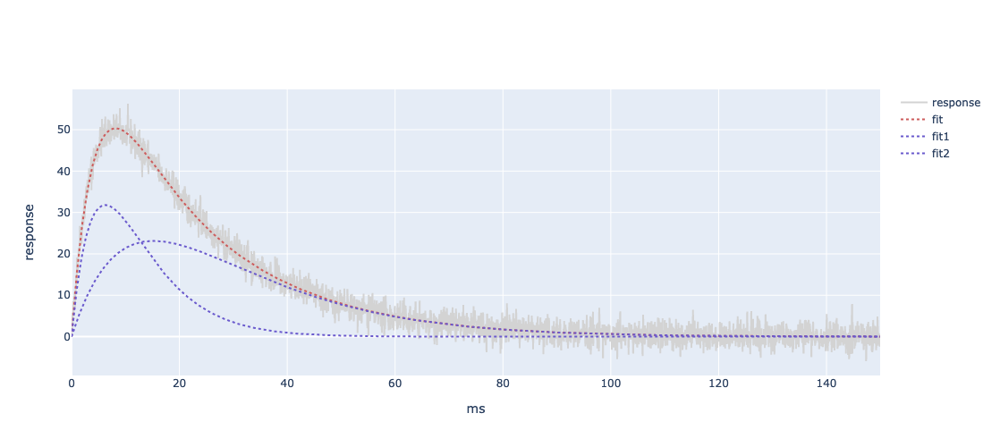

              A1       τ r20-80  d80-20     area
fast:     31.800   6.271  2.458  13.607  542.072
slow:     23.135  15.226  5.969   33.04  957.553
AIC:   12595.161                                


In [29]:
np.random.seed(42)
FITalpha2(x, y)
nFIT(x=x, y=y, model='alpha2')

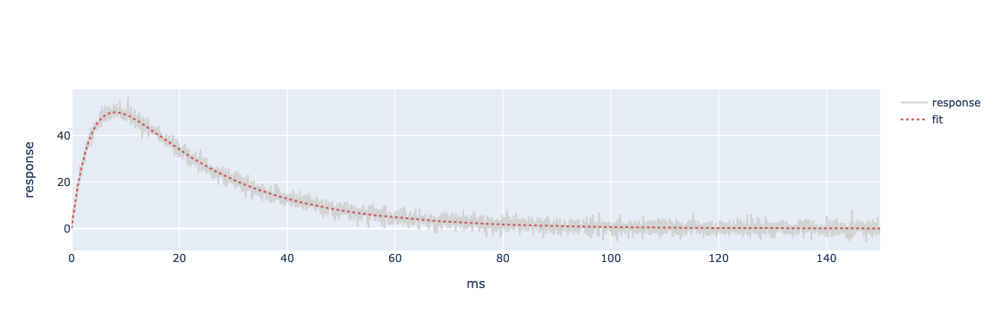

           peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fit:     49.961  3.984  20.179  8.054     3.005     28.757  1502.638
AIC:  12597.347                                                     


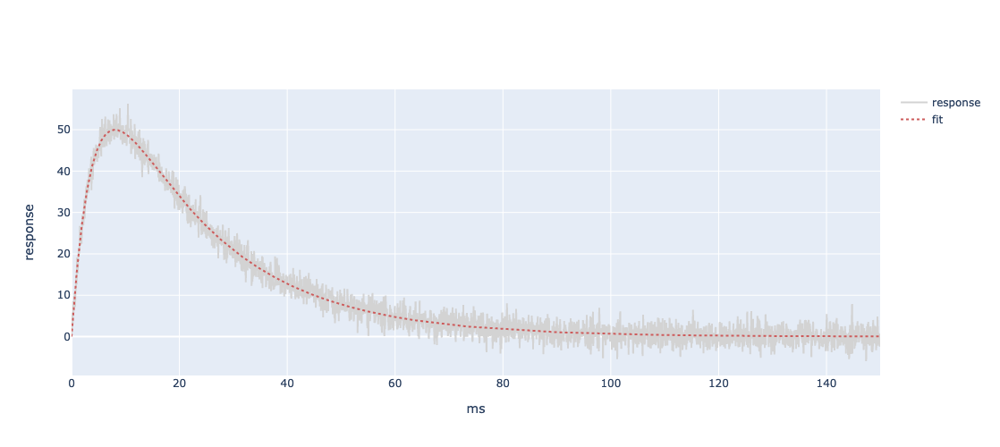

             A1  τrise  τdecay  tpeak r20-80  d80-20      area
fit:     49.961  3.984  20.179  8.054  3.005  28.757  1502.638
AIC:  12597.349                                               


In [30]:
np.random.seed(42)
FITproduct(x, y)
nFIT(x=x, y=y, model='product')

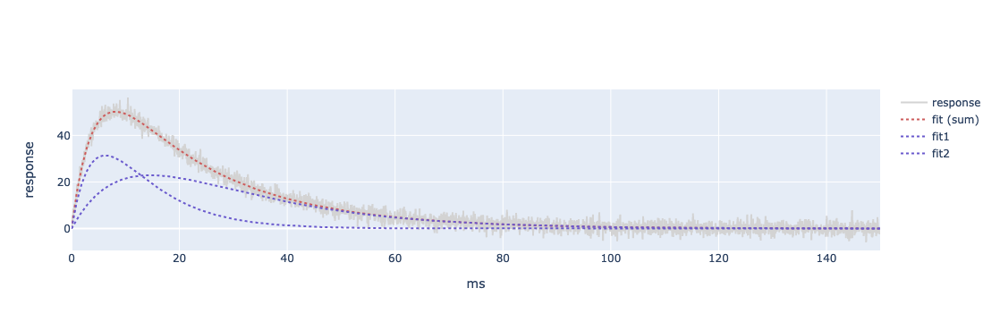

            peak   τrise  τdecay   tpeak rise20-80 decay80-20     area
fast:     31.419   4.684   8.584   6.245     2.431     14.583  558.236
slow:     22.930  11.277  19.441  14.625     5.701     33.678  945.887
AIC:   12595.143                                                      


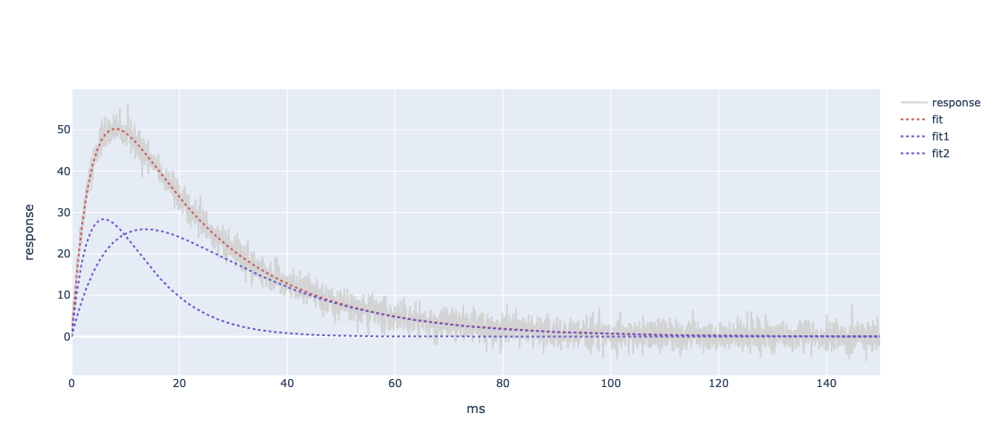

              A1  τrise  τdecay   tpeak r20-80  d80-20      area
fast:     28.383  4.892   7.506   6.013  2.349  13.537   474.692
slow:     25.975  9.889  19.843  13.729  5.333  32.822  1029.579
AIC:   12595.184                                                


In [31]:
np.random.seed(42)
FITproduct2(x, y)
nFIT(x=x, y=y, model='product2')

In [32]:
np.random.seed(42) # set a seed to make egs reproducible
params = [35, 5, 15, 15, 10, 30] 
dt = 0.05
x = np.arange(0, 100, dt) 
# y = product2(params, x) + np.random.normal(0,2,len(x))
y = product2_alt(params, x) + np.random.normal(0,2,len(x))


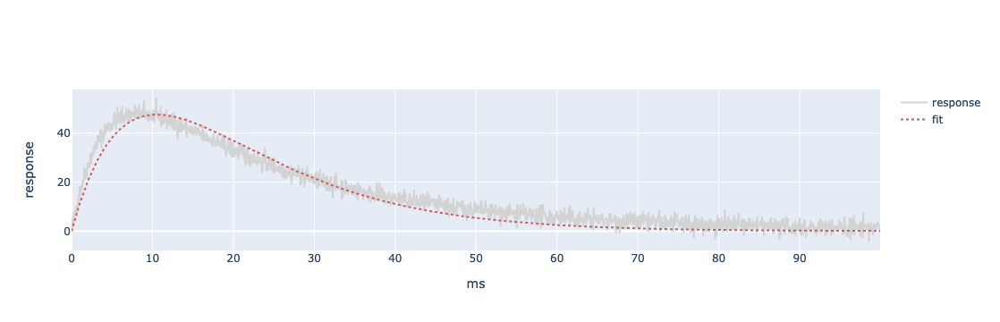

           peak       τ rise20-80 decay80-20      area
fit:     47.616  10.561      4.14     22.917  1366.978
AIC:  10670.003                                       


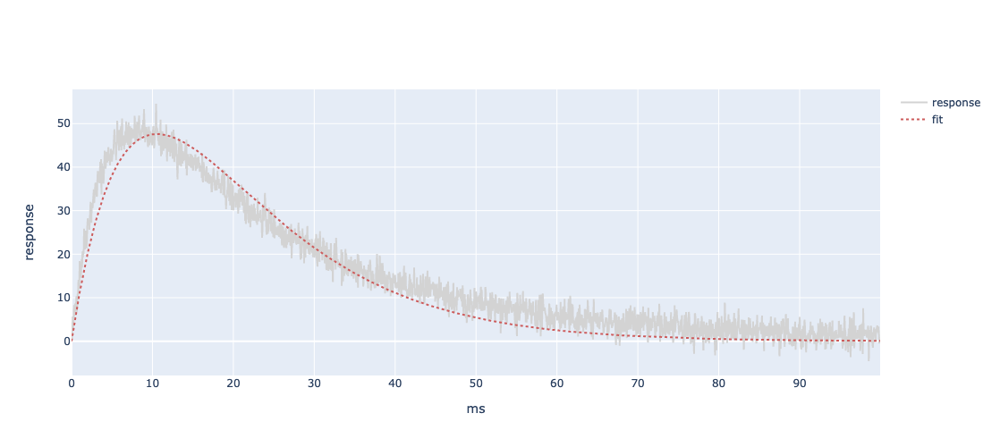

             A1       τ r20-80  d80-20      area
fit:     47.616  10.561   4.14  22.917  1366.978
AIC:  10670.004                                 


In [33]:
np.random.seed(42)
FITalpha(x, y)
nFIT(x=x, y=y, model='alpha')

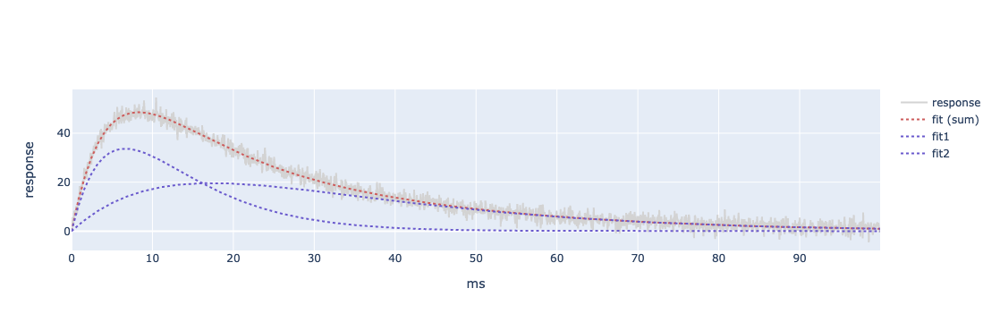

           peak       τ rise20-80 decay80-20     area
fast:    33.686   6.637     2.602     14.401  607.719
slow:    19.625  17.416     6.827     37.792  929.103
AIC:   8422.464                                      


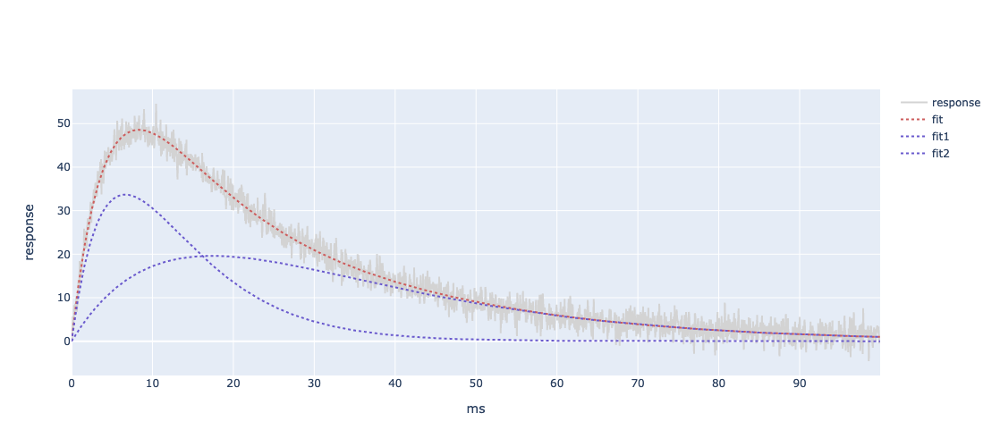

             A1       τ r20-80  d80-20     area
fast:    33.686   6.637  2.602  14.401  607.719
slow:    19.625  17.416  6.827  37.792  929.103
AIC:   8422.468                                


In [34]:
np.random.seed(42)
FITalpha2(x, y)
nFIT(x=x, y=y, model='alpha2')

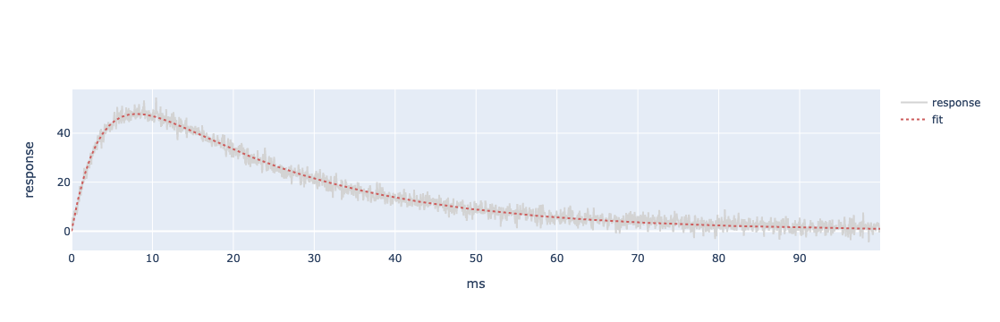

          peak  τrise  τdecay  tpeak rise20-80 decay80-20      area
fit:    47.885  3.764  22.301  8.057     2.976     31.497  1532.579
AIC:  8454.057                                                     


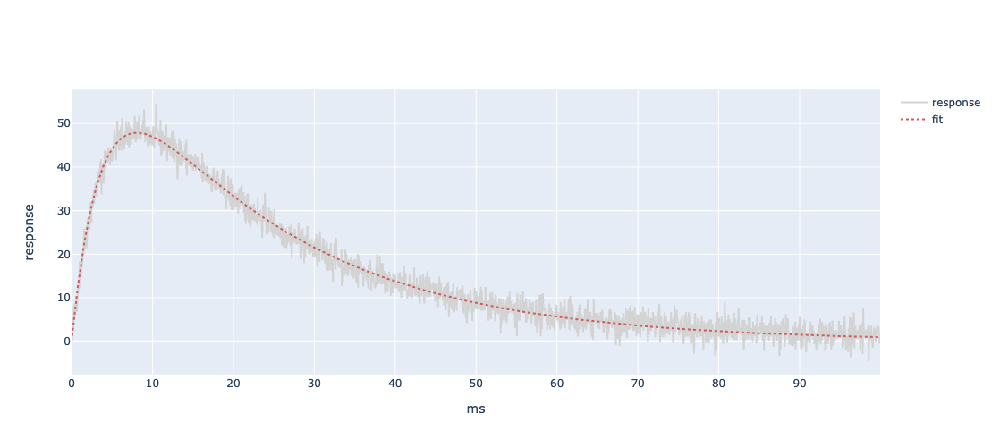

            A1  τrise  τdecay  tpeak r20-80  d80-20      area
fit:    47.885  3.764  22.301  8.057  2.976  31.497  1532.579
AIC:  8454.059                                               


In [35]:
np.random.seed(42)
FITproduct(x, y)
nFIT(x=x, y=y, model='product')

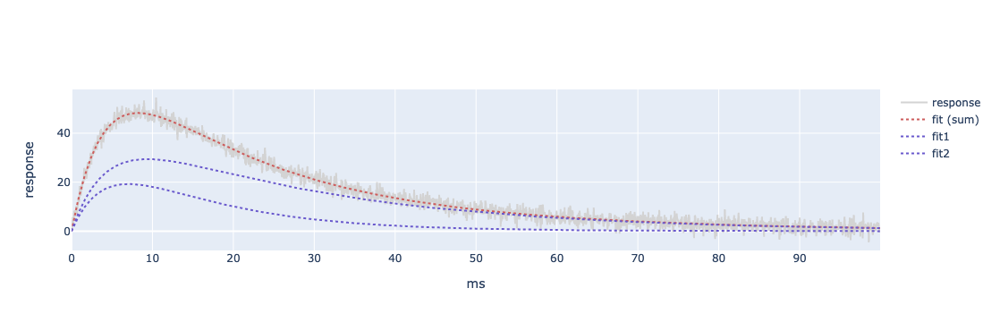

           peak  τrise τdecay  tpeak rise20-80 decay80-20      area
fast:    19.256  4.276  12.83  7.047       2.7     19.397   427.879
slow:    29.422  4.277   27.1  9.377     3.448     38.159  1126.987
AIC:   8405.140                                                    


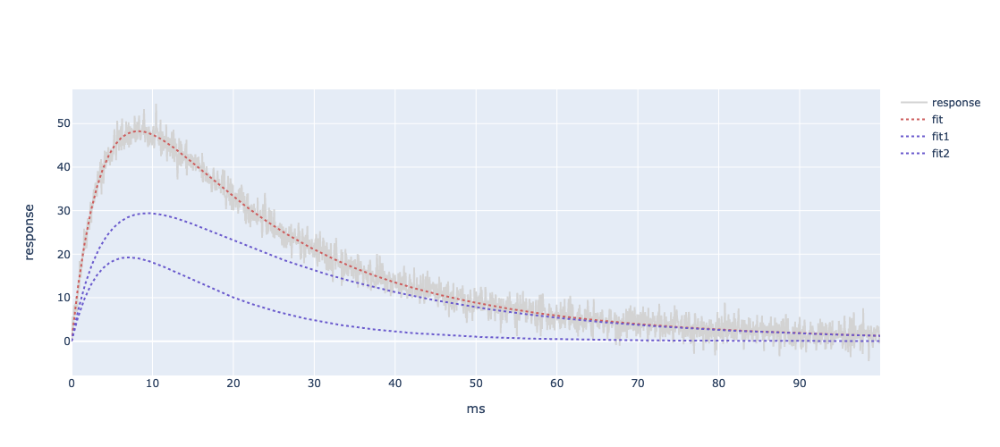

             A1  τrise  τdecay  tpeak r20-80  d80-20     area
fast:    19.256  4.276  12.831  7.047  2.701  19.399  427.917
slow:    29.422  4.276  27.101  9.376  3.447   38.16  1126.95
AIC:   8405.149                                              


In [36]:
np.random.seed(42)
FITproduct2(x, y)
nFIT(x=x, y=y, model='product2')

In [37]:
# batch examples

In [38]:
np.random.seed(42) # set a seed to make egs reproducible
bl = 20 # baseline
dt = 0.05
ISI = 20  
xmax = 220
rms = 2
n = 1

idx = int(bl/dt) - 1

x1 = np.arange(0, xmax-bl, dt)

params1 = [50, 10] 
params1 = List([p for p in params1])
y1 = model_n(params1, ISI=ISI, n=n, x=x1, model='alpha')[1]

y1 = np.concatenate([np.zeros(idx), y1])
x = np.arange(0, len(y1))*dt
y1 = y1 + np.random.normal(0, rms, len(x))

params2 = [30, 5, 35, 25] 
params2 = List([p for p in params2])
y2 = model_n(params2, ISI=ISI, n=n, x=x1, model='alpha2')[1]
y2 = np.concatenate([np.zeros(idx), y2])
y2 = y2 + np.random.normal(0, rms, len(x))

params3 = [50, 5, 20] 
params3 = List([p for p in params3])
y3 = model_n(params3, ISI=ISI, n=n, x=x1, model='product')[1]
y3 = np.concatenate([np.zeros(idx), y3])
y3 = y3 + np.random.normal(0, rms, len(x))

params4 = [20, 5, 10, 40, 15, 55] 
params4 = List([p for p in params4])
y4 = model_n(params4, ISI=ISI, n=n, x=x1, model='product2')[1]
y4 = np.concatenate([np.zeros(idx), y4])
y4 = y4 + np.random.normal(0, rms, len(x))

df = pd.DataFrame({'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4})


In [39]:
np.random.seed(42) # set a seed to make egs reproducible
bl = 20 # baseline
dt = 0.05
ISI = 50  
xmax = 240
rms = 2
n = 2

idx = int(bl/dt) - 1

x1 = np.arange(0, xmax-bl, dt)

params1 = [50, 70, 10] 
params1 = List([p for p in params1])
y1 = model_n(params1, ISI=ISI, n=n, x=x1, model='alpha')[1]

y1 = np.concatenate([np.zeros(idx), y1])
x = np.arange(0, len(y1))*dt
y1 = y1 + np.random.normal(0, rms, len(x))

# params2 = [30, 60, 5, 35, 45, 25] 
params2 = [50, 80, 5, 20, 30, 15] 
params2 = List([p for p in params2])
y2 = model_n(params2, ISI=ISI, n=n, x=x1, model='alpha2')[1]
y2 = np.concatenate([np.zeros(idx), y2])
y2 = y2 + np.random.normal(0, rms, len(x))

params3 = [50, 70, 5, 20] 
params3 = List([p for p in params3])
y3 = model_n(params3, ISI=ISI, n=n, x=x1, model='product')[1]
y3 = np.concatenate([np.zeros(idx), y3])
y3 = y3 + np.random.normal(0, rms, len(x))

params4 = [20, 30, 5, 10, 40, 60, 15, 55] 
params4 = List([p for p in params4])
y4 = model_n(params4, ISI=ISI, n=n, x=x1, model='product2')[1]
y4 = np.concatenate([np.zeros(idx), y4])
y4 = y4 + np.random.normal(0, rms, len(x))

df = pd.DataFrame({'y1': y1, 'y2': y2, 'y3': y3, 'y4': y4})


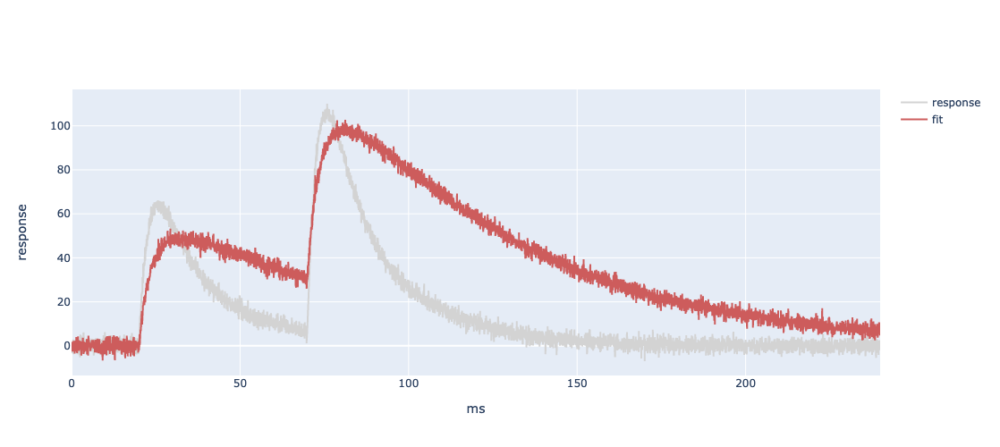

In [40]:
# Create the figure
fig1 = go.Figure()

# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y2, name='response', line=dict(color='lightgray')))

# Add the fitted curve
y_fit = np.sum(all_y, axis=0)
fig1.add_trace(go.Scatter(x=x, y=y4, name='fit', line=dict(color='indianred')))

# Set the axis labels
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')

fig1.show() 


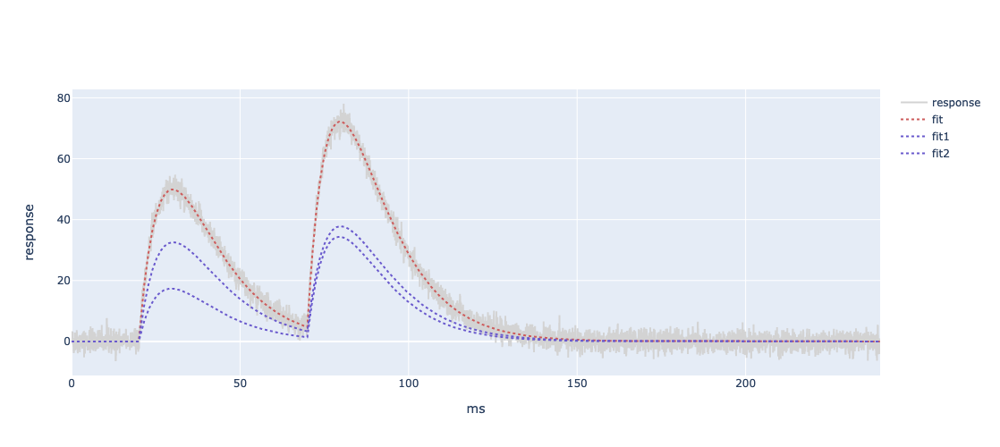

              A1      A2       τ r20-80  d80-20      area
fast:     17.352  33.774   9.682  3.795  21.009  1345.518
slow:     32.572  36.334  10.276  4.028  22.297  1924.691
AIC:   18578.368                                         


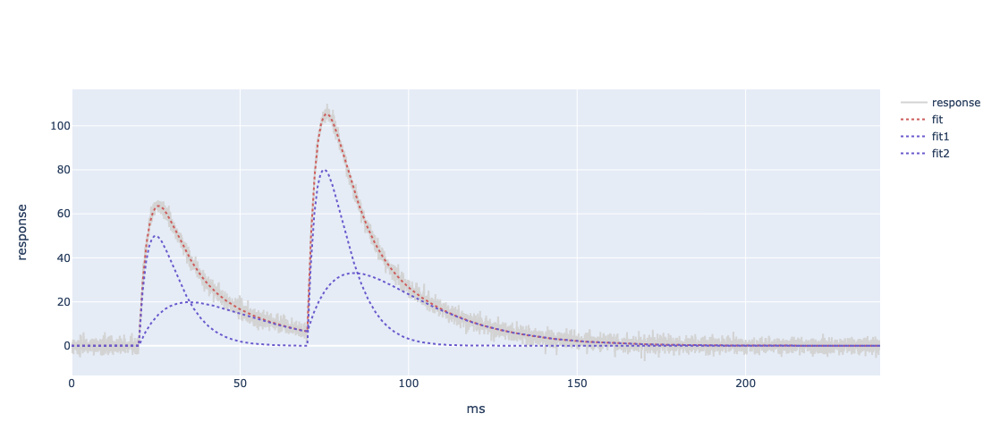

              A1      A2       τ r20-80  d80-20      area
fast:     50.003  80.099   4.988  1.955  10.824  1764.023
slow:     19.899  29.928  15.019  5.887   32.59  2034.245
AIC:   18744.084                                         


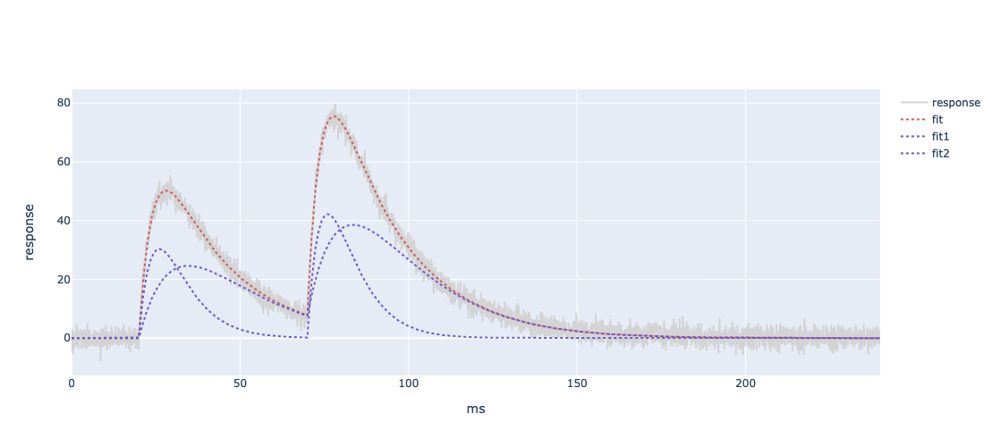

              A1      A2       τ r20-80  d80-20      area
fast:     30.294  42.074   6.088  2.387  13.211  1197.644
slow:     24.614  34.831  14.714  5.768  31.929  2377.686
AIC:   18620.557                                         


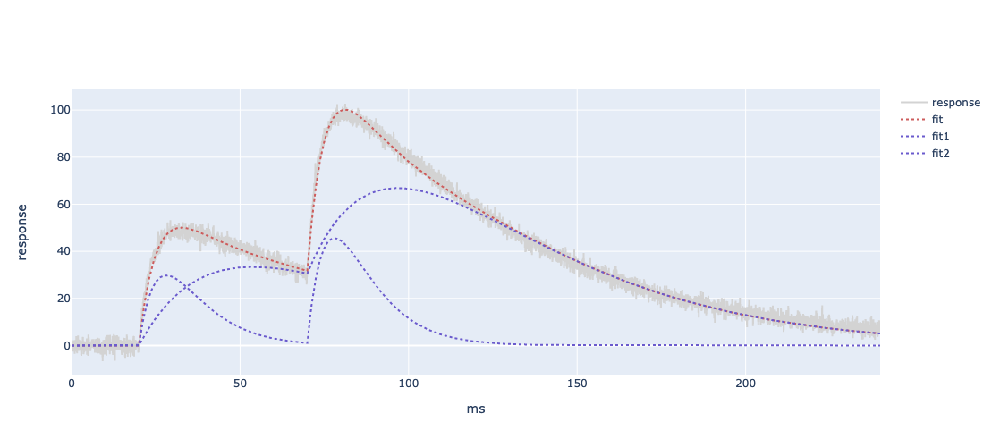

              A1      A2       τ  r20-80  d80-20      area
fast:     29.795  45.076   8.179   3.206  17.748  1664.638
slow:     33.393  46.762  33.841  13.265  73.432  7373.359
AIC:   20058.295                                          


In [41]:
np.random.seed(42) # set a seed to make egs reproducible
out = nFITbatch(x, df, n=n, ISI=ISI, bl=bl, model='alpha2')

In [42]:
out[0]

,A1,A2,τ,r20-80,d80-20,area,A1,A2,τ,r20-80,d80-20,area,σ
0,17.352,33.774,9.682,3.795,21.009,1345.518,32.572,36.334,10.276,4.028,22.297,1924.691,1.917
1,50.003,80.099,4.988,1.955,10.824,1764.023,19.899,29.928,15.019,5.887,32.590,2034.245,1.980
2,30.294,42.074,6.088,2.387,13.211,1197.644,24.614,34.831,14.714,5.768,31.929,2377.686,1.912
3,29.795,45.076,8.179,3.206,17.748,1664.638,33.393,46.762,33.841,13.265,73.432,7373.359,2.066


In [43]:
out[1]

,AIC
0,18578.368
1,18744.084
2,18620.557
3,20058.295


In [44]:
# common definitions
nsims = 10000
dt = 0.05
x = np.arange(0, 100, dt) 
rms = 2
criterion = 'AIC'
fit_method = 'LS'
N = 10

bl = 20 # baseline
n = 1 # number of responses in a train
ISI = 50 # inter-stimulus interval
xmax = 150

fit_model = ['alpha', 'alpha2', 'product', 'product2']
fits_keys = ['fits1', 'fits2', 'fits3', 'fits4']
AIC_keys = ['AIC1', 'AIC2', 'AIC3', 'AIC4']
    
col_names_list = { 
    'fits1': get_column_names(model='alpha', n=n),
    'fits2': get_column_names(model='alpha2', n=n),
    'fits3': get_column_names(model='product', n=n),
    'fits4': get_column_names(model='product2', n=n)
}

idx = int(bl/dt) - 1
x1 = np.arange(0, xmax-bl, dt)
x = np.arange(0, xmax-dt, dt)


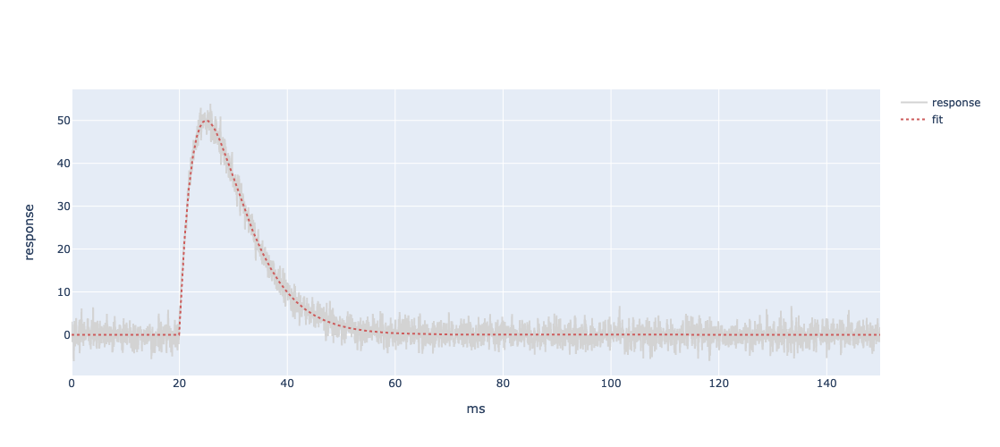

In [45]:
###################################################### sim1 ######################################################
# simulates alpha function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist1 = []
params = [50, 5] 
params = List([p for p in params])

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist1.append(y)

# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig1 = go.Figure()
# Add the original data
fig1.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig1.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig1.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig1.show()  


In [46]:
# run sim
sim1 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist1):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim1[fits_key].append(fits)
        sim1[AIC_key].append(AIC)

100%|███████████████████████████████████| 10000/10000 [1:42:59<00:00,  1.62it/s]


In [47]:
df1_fits1 = extract_summary_stats(sim1, 'fits1', col_names=col_names_list['fits1'])
print(df1_fits1)

              A1      τ  r20-80  d80-20     area      σ
upper ci  50.331  5.034   1.973  10.923  684.145  2.140
mean      49.999  5.000   1.960  10.850  679.565  1.998
lower ci  49.676  4.967   1.947  10.777  675.084  1.861
median    49.997  5.000   1.960  10.849  679.552  1.997
sd         0.168  0.017   0.007   0.037    2.285  0.071


In [48]:
print(IC_model(data_dict=sim1, model=0, criterion='AIC'))

0.9101


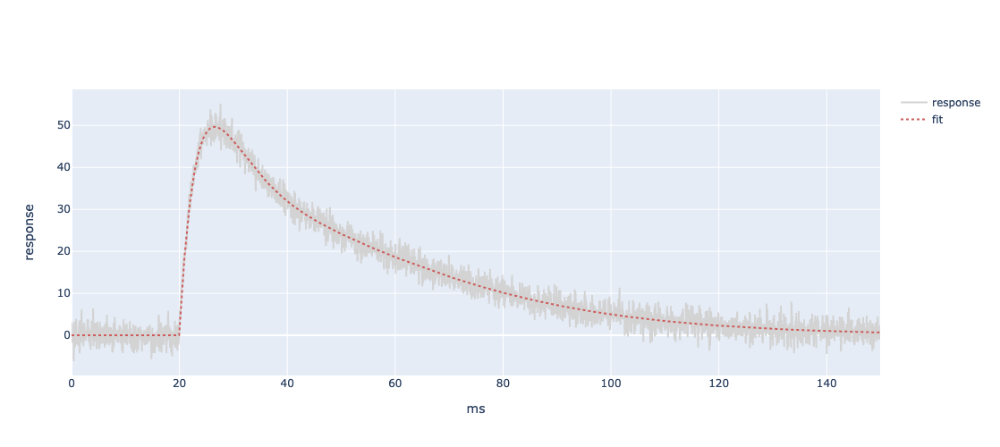

In [49]:
###################################################### sim2 ######################################################
# simulates alpha2 function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist2 = []
params = [35, 5, 25, 20] 
params = List([p for p in params])

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha2')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist2.append(y)

# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='alpha2')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig2 = go.Figure()
# Add the original data
fig2.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig2.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig2.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig2.show()  



In [50]:
# run sim
sim2 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist2):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim2[fits_key].append(fits)
        sim2[AIC_key].append(AIC)

100%|█████████████████████████████████████| 10000/10000 [49:34<00:00,  3.36it/s]


In [51]:
df2_fits2 = extract_summary_stats(sim2, 'fits2', col_names=col_names_list['fits2'])
print(df2_fits2)

              A1      τ  r20-80  d80-20     area      A1       τ  r20-80  \
upper ci  35.439  5.086   1.994  11.037  487.299  25.417  20.238   7.933   
mean      35.002  5.001   1.960  10.851  475.784  24.997  20.002   7.841   
lower ci  34.541  4.918   1.928  10.673  464.477  24.569  19.769   7.750   
median    35.002  5.000   1.960  10.851  475.767  24.998  20.002   7.841   
sd         0.230  0.043   0.017   0.093    5.877   0.215   0.119   0.047   

          d80-20      area      σ  
upper ci  43.915  1371.094  2.140  
mean      43.403  1359.048  1.998  
lower ci  42.898  1346.526  1.861  
median    43.402  1359.096  1.997  
sd         0.259     6.259  0.071  


In [52]:
print(IC_model(data_dict=sim2, model=1, criterion='AIC'))

0.9833


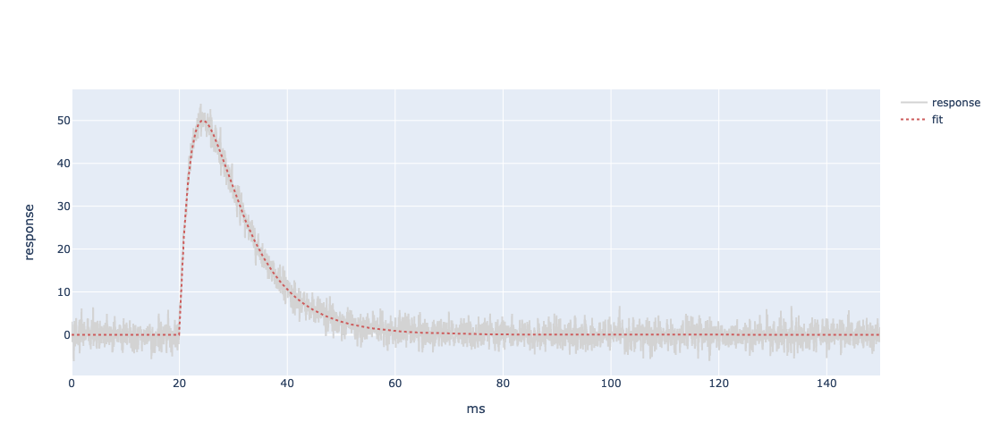

In [53]:
###################################################### sim3 ######################################################
# simulates alpha2 function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist3 = []
params = [50, 4, 8] 
params = List([p for p in params])

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='product')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist3.append(y)

# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='product')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig3 = go.Figure()
# Add the original data
fig3.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig3.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig3.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig3.show()  


In [54]:
# run sim
sim3 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist3):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim3[fits_key].append(fits)
        sim3[AIC_key].append(AIC)

100%|███████████████████████████████████| 10000/10000 [1:25:03<00:00,  1.96it/s]


In [55]:
df3_fits3 = extract_summary_stats(sim3, 'fits3', col_names=col_names_list['fits3'])
print(df3_fits3)

              A1  τrise  τdecay  tpeak  r20-80  d80-20     area      σ
upper ci  50.341  2.769   8.202  4.456   1.711  12.288  698.515  2.140
mean      49.999  2.668   7.998  4.395   1.684  12.095  692.791  1.998
lower ci  49.660  2.571   7.793  4.335   1.658  11.905  687.071  1.861
median    49.997  2.668   7.997  4.395   1.684  12.093  692.788  1.997
sd         0.175  0.051   0.103  0.031   0.014   0.097    2.892  0.071


In [56]:
print(IC_model(data_dict=sim3, model=2, criterion='AIC'))

0.7911


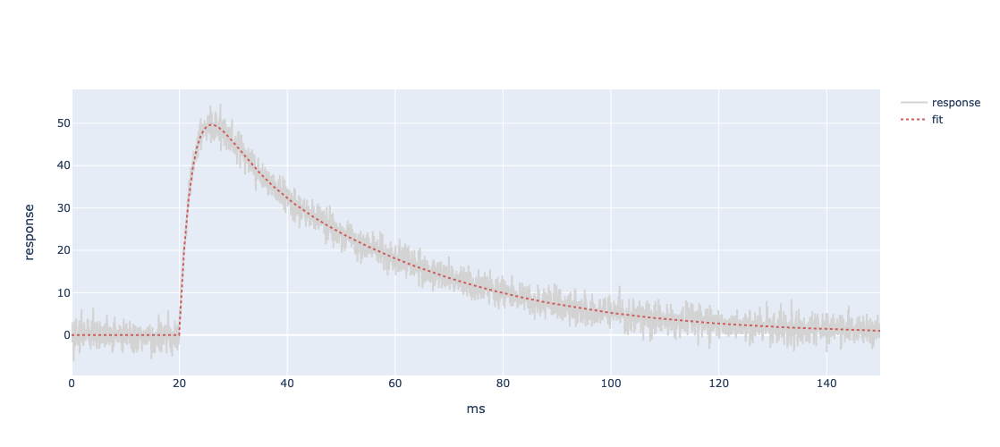

In [57]:
###################################################### sim4 ######################################################
# simulates alpha2 function with params specified below and fits 4 functions for comparison
# default optimised starting values from curve_fit 
ylist4 = []
params = [35, 4, 8, 25, 20, 30] 
params = List([p for p in params])

np.random.seed(42) 
for ii in list(range(nsims)):
    y = model_n(params, ISI=ISI, n=n, x=x1, model='product2')[1] 
    y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    
    ylist4.append(y)


# Create single eg figure
all_y, y = model_n(params, ISI=ISI, n=n, x=x1, model='product2')
# Add the fitted curve
y_fit = np.concatenate([np.zeros(idx), np.sum(all_y, axis=0)])
y = np.concatenate([np.zeros(idx), y]) + np.random.normal(0, rms, len(x))    

fig4 = go.Figure()
# Add the original data
fig4.add_trace(go.Scatter(x=x, y=y, name='response', line=dict(color='lightgray')))
# Add the fitted curve
fig4.add_trace(go.Scatter(x=x, y=y_fit, name='fit', line=dict(color='indianred', dash='dot')))
# Set the axis labels
fig4.update_layout(width=1000,  height=500, xaxis_title='ms',yaxis_title='response')
fig4.show()  



In [58]:
# run sim
sim4 = {
    'fits1':   [],
    'fits2':   [],
    'fits3':   [],
    'fits4':   [],
    'AIC1':   [],
    'AIC2':   [],
    'AIC3':   [],
    'AIC4':   [],
}

for y in tqdm(ylist4):
    for model, fits_key, AIC_key in zip(fit_model, fits_keys, AIC_keys):
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            results = nFIT(x=x, y=y, n=n, ISI=ISI, bl=bl, model=model, criterion=criterion, plot=False, fit_method=fit_method, N=N, show_results=True)
            fits, AIC = results
        sim4[fits_key].append(fits)
        sim4[AIC_key].append(AIC)

100%|███████████████████████████████████| 10000/10000 [1:35:41<00:00,  1.74it/s]


In [59]:
df4_fits4 = extract_summary_stats(sim4, 'fits4', col_names=col_names_list['fits4'])
print(df4_fits4)

              A1  τrise  τdecay  tpeak  r20-80  d80-20     area      A1  \
upper ci  38.218  3.799  10.195  4.665   1.766  14.802  613.686  34.676   
mean      31.605  3.126   6.366  4.194   1.622  10.615  404.269  28.103   
lower ci  23.568  2.466   3.842  3.595   1.408   7.841  231.592  21.210   
median    31.306  3.039   5.777  4.178   1.624   9.751  370.693  28.847   
sd         4.127  0.471   2.779  0.363   0.115   3.258  144.530   3.979   

           τrise  τdecay   tpeak  r20-80  d80-20      area      σ  
upper ci  16.339  32.951  20.822   8.120  48.071  1646.899  2.140  
mean       9.914  30.686  16.247   6.208  46.429  1465.366  1.998  
lower ci   5.396  26.743  11.673   4.300  45.620  1247.383  1.861  
median     9.156  31.190  15.880   6.053  46.508  1498.925  1.997  
sd         2.936   2.462   2.591   1.070   2.820   147.203  0.071  


In [60]:
print(IC_model(data_dict=sim4, model=3, criterion='AIC'))

0.9996


In [61]:
################################### to save for analysis ###################################
names = ['sim1', 'sim2', 'sim3', 'sim4']

# Create a dictionary only with the variables that are defined
list_dict = {}
for name in names:
    var = locals().get(name)
    if var is not None:
        list_dict[name] = var

# # Print out the names of variables that have been found and added to the dictionary
# print(f"Variables found and added to the dictionary: {', '.join(list_dict.keys())}")

# create dir to save data in
sim_dir = "curve fits"
if not os.path.exists(sim_dir):
    os.mkdir(sim_dir)

# Save the dictionaries as pickle files for each name
for name, sim_data in list_dict.items():
    file_path = '{}/{}.pickle'.format(sim_dir, name)
    with open(file_path, 'wb') as handle:
        pickle.dump(sim_data, handle, protocol=pickle.HIGHEST_PROTOCOL)
        